# Creation of Relative Elevation Model for Buffalo Bayou - Regional View

## Getting the initial DEM (Digital Elevation Model)

The digital elevation model or DEM used in this repository (most of which is only on local computer due to size of some of the files)
came from [Open Topography's](https://opentopography.org/) topographic data locator and download tools. 

The dataset itself is sourced from USGS (United Stats Geologic Survey), specifically the 
USGS 1/3 arc-second Digital Elevation Model(USGS10m). More detailed information can be found in the metadata file
`python_data_processing/data/input_rem_data/metadata-rt1716147037733.txt`.
The dataset was download to a bounding box boundary selected in Open Topography's web portal as a tiff file with 
multi-directional hillshade with 20x exaggeration. The hillshade method and exaggeration are user selections.
Boundary edges are Xmin = -96.207303	  Ymin = 29.324906	  Xmax = -94.634402	  Ymax = 30.083256.
The `input_rem_data` directory has the various files that were exported from Open Topography. This includes: 
- A tiff file: [buffaloBayouRegionalV1_USGS10m.tif](../data/input_rem_data/buffaloBayouRegionalV1_USGS10m.tif)
- A metadata file that describes what was downloaded from where [metadata-rt1716147037733.txt](../data/input_rem_data/metadata-rt1716147037733.txt)
- A raster file [rasters_USGS10m.tar.gz](../data/input_rem_data/rasters_USGS10m.tar.gz)
- Zipped version of the kmz [viz.tar.gz](../data/input_rem_data/viz.tar.gz)
- KMZ file of the DEM with hillshade that can be dropped into Google Earth Pro [viz.USGS10m_hillshade.kmz](../data/input_rem_data/viz.USGS10m_hillshade.kmz)


These are not all pushed into the remote repository on GitHub to avoid slowing down the website that is also in the 
repository. However, all of these files can be found in 
a [google drive folder](https://drive.google.com/drive/folders/1rsUcOLENkj3Mep1P0wf--2rS9FM__Kza?usp=drive_link).

The job used to create the TIFF from the raw USGS data API is at: 
https://portal.opentopography.org/rasterOutput?jobId=rt1716147037733

In [1]:
### Various geospatial packages
import geopandas as gpd
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import show
from rasterio.warp import calculate_default_transform
from rasterio.warp import reproject, Resampling
from rasterio.plot import show

In [2]:
### For working with PNG files
from PIL import Image
import numpy as np

In [3]:
from shapely.geometry import box
### this is the python package for relative elevation models for rivers
import riverrem

### OSX for open street map overpass data
import osmnx as ox

In [4]:
# Specify the path to the shapefile
shp_flowlines_path = "../data/input_rem_data/NHDPlus12/NHDPlusTX/NHDPlus12/NHDSnapshot/Hydrography/NHDFlowline.shp"

# Load the shapefile using geopandas
gdf_flow = gpd.read_file(shp_flowlines_path)


<AxesSubplot:>

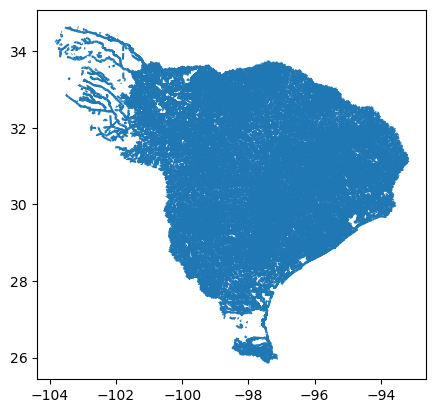

In [29]:
gdf_flow.plot()

### That's.... a lot. 
### Let's only get the flowlines we care about

In [31]:
gdf_flow[0:4]

,COMID,FDATE,RESOLUTION,GNIS_ID,GNIS_NAME,LENGTHKM,REACHCODE,FLOWDIR,WBAREACOMI,FTYPE,FCODE,SHAPE_LENG,ENABLED,GNIS_NBR,geometry
0,8333312,1999-06-25,Medium,None,None,0.723,08080206012159,Uninitialized,0,CanalDitch,33600,0.007254,True,0,"LINESTRING Z (-93.64348 29.95617 0.00000, -93...."
1,8332462,2000-06-07,Medium,None,None,6.833,08080206012160,Uninitialized,0,CanalDitch,33600,0.070591,True,0,"LINESTRING Z (-93.54474 30.02260 0.00000, -93...."
2,8333540,1999-06-25,Medium,None,None,8.773,08080206012161,Uninitialized,0,CanalDitch,33600,0.084409,True,0,"LINESTRING Z (-93.60120 29.99527 0.00000, -93...."
3,8333322,2008-06-13,Medium,542250,East Fork of Right Prong Black Bayou,2.064,08080206012162,With Digitized,0,StreamRiver,46006,0.020147,True,0,"LINESTRING Z (-93.62245 29.95131 0.00000, -93...."


In [32]:
gdf_flow.columns

Index(['COMID', 'FDATE', 'RESOLUTION', 'GNIS_ID', 'GNIS_NAME', 'LENGTHKM',
       'REACHCODE', 'FLOWDIR', 'WBAREACOMI', 'FTYPE', 'FCODE', 'SHAPE_LENG',
       'ENABLED', 'GNIS_NBR', 'geometry'],
      dtype='object')

In [33]:
unique_ftypes = gdf_flow['FTYPE'].unique()
print(unique_ftypes)

['CanalDitch' 'StreamRiver' 'ArtificialPath' 'Pipeline' 'Connector'
 'Coastline']


In [34]:
unique_ftypes = gdf_flow['FTYPE'].unique()
print(unique_ftypes)

['CanalDitch' 'StreamRiver' 'ArtificialPath' 'Pipeline' 'Connector'
 'Coastline']


In [35]:
import numpy as np

# Set the print options
np.set_printoptions(threshold=np.inf)

unique_ftypes = gdf_flow['GNIS_NAME'].unique()
print(unique_ftypes)

[None 'East Fork of Right Prong Black Bayou' 'Sabine River' 'Keys Creek'
 'Leatherman Creek' 'Franks Creek' 'Sandy Creek'
 'Cowleech Fork Sabine River' 'Timber Creek' 'Caddo Creek'
 'East Caddo Creek' 'West Caddo Creek' 'Elm Creek' 'Clendining Creek'
 'Brushy Creek' 'South Fork Sabine River' 'Sabine Creek' 'Mill Creek'
 'Crooked Creek' 'Chinguapin Branch' 'Grand Saline Creek' 'Dry Creek'
 'Village Creek' 'Big Creek' 'Block Branch' 'Briar Branch' 'Caney Creek'
 'Chrestman Branch' 'Coon Creek' 'Cottonwood Creek' 'Cowskin Creek'
 'Dodds Creek' 'Farber Creek' 'Giladon Creek' 'Long Branch'
 'Middle Caddo Creek' 'Renfro Creek' 'Simpkins Creek' 'Warren Branch'
 'Wolf Creek' 'Little Wolf Creek' 'Bearfield Branch' 'Bearpen Creek'
 "Bois d'Arc Creek" 'Glade Creek' 'Hickory Creek' 'Horse Creek'
 'McBee Creek' 'Pond Branch' 'Rock Creek' 'Tidwell Creek' 'Lankford Creek'
 'Wellon Creek' 'Davis Branch' 'Allread Creek' 'Spring Branch'
 'Bear Creek' 'Muscadine Branch' 'West Brushy Branch' 'Shuffle Cree

In [36]:
gdf_flow_rivers = gdf_flow[gdf_flow['FTYPE'] == 'StreamRiver']
gdf_flow_rivers = gdf_flow_rivers[gdf_flow_rivers['GNIS_NAME'] != 'None']



<AxesSubplot:>

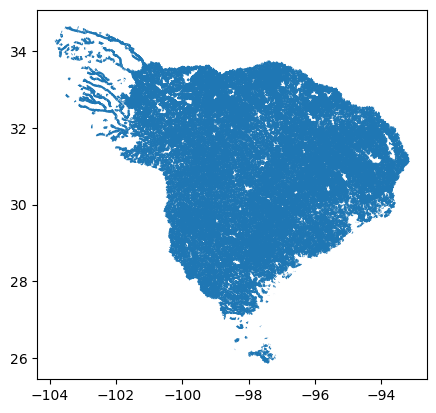

In [37]:
gdf_flow_rivers.plot()

<AxesSubplot:>

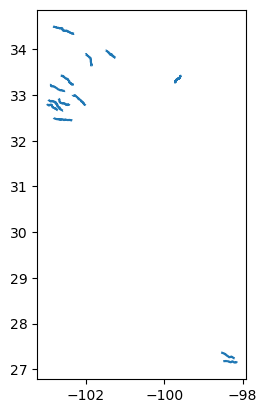

In [38]:
gdf_flow_rivers_lineLength = gdf_flow_rivers[gdf_flow_rivers['LENGTHKM'] > 40]
gdf_flow_rivers_lineLength.plot()

<AxesSubplot:>

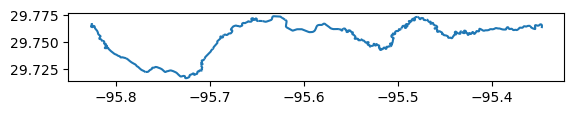

In [39]:
buffalo_bayou = gdf_flow_rivers[gdf_flow_rivers['GNIS_NAME'] == 'Buffalo Bayou']
buffalo_bayou.plot()

<AxesSubplot:>

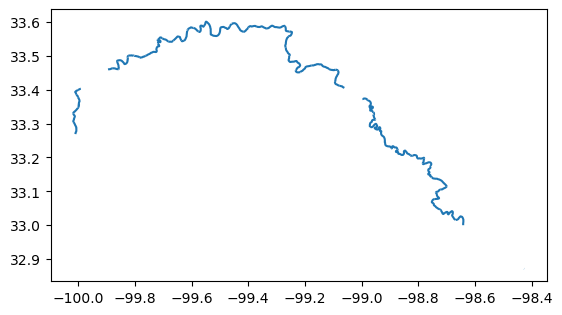

In [40]:
BrazosRiver = gdf_flow_rivers[gdf_flow_rivers['GNIS_NAME'] == 'Brazos River']
BrazosRiver.plot()

In [61]:
# Assuming you have a GeoPandas DataFrame named 'gdf' and a string to search named 'search_string'
San_Jacinto_River = gdf_flow_rivers[gdf_flow_rivers['GNIS_NAME'].str.contains('San Jacinto', na=False)]

<AxesSubplot:>

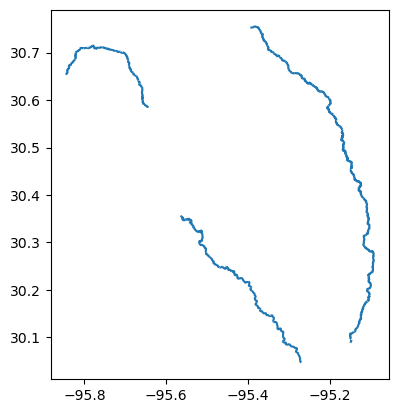

In [62]:
San_Jacinto_River.plot()

<AxesSubplot:>

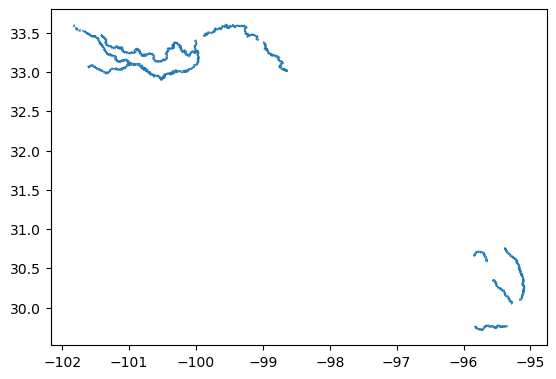

In [67]:
# Define the list of strings to search for
search_strings = ['San Jacinto', 'Brazos', 'Buffalo Bayou']

# Filter the gdf_flow_rivers DataFrame based on the search strings
filtered_df = gdf_flow_rivers[gdf_flow_rivers['GNIS_NAME'].str.contains('|'.join(search_strings), na=False)]

# Print the filtered DataFrame
filtered_df.plot()

In [69]:
# Specify the path to the shapefile
shp_lines_path = "../data/input_rem_data/NHDPlus12/NHDPlusTX/NHDPlus12/NHDSnapshot/Hydrography/NHDline.shp"

# Load the shapefile using geopandas
gdf_lines = gpd.read_file(shp_lines_path)

<AxesSubplot:>

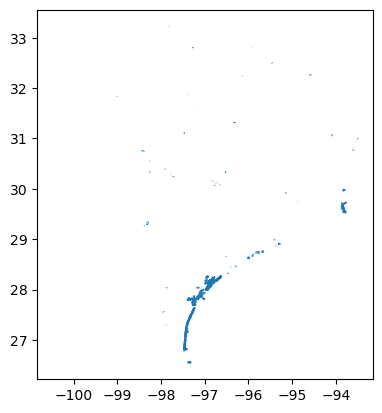

In [70]:
gdf_lines.plot()

## Ugh, can't seem to get just lines of larger rivers from this

## Skipping that for now and just going REM

Maybe later try to get river polylines from https://gis-tceq.opendata.arcgis.com/maps/175c3cb32f2840eca2bf877b93173ff9/explore?location=31.055290%2C-99.835600%2C6.78

## Bring and plot the DEM tiff file from Open Topography

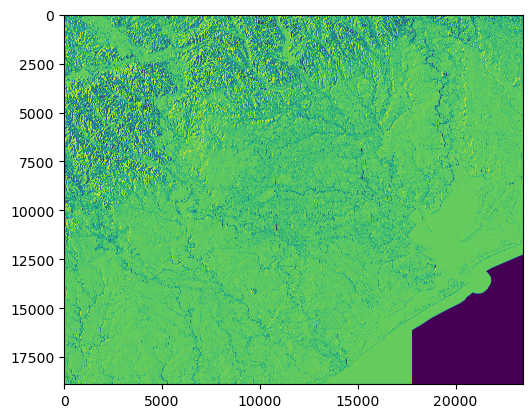

In [41]:
# Load the TIFF
with rasterio.open('../data/input_rem_data/v2/viz.USGS10m_hillshade.tif') as src:
    img = src.read(1)  # read the first band
    
# Plot the TIFF
fig, ax = plt.subplots(1, 1)
show(img, ax=ax)
plt.show()

## What we need before making a relative elevation model
If give only the DEM to the riverrem package, it finds the largest river in the area
and then uses that as the center line. 

However, we want to focus on Buffalo Bayou. Experience in preceeding notebook has told us that only supplying the centerline of Buffalo bayou leads to weird artifact when a large area is relative to a small bayou, so instead we will use both a center line of Brazos River (big river on left) and Buffalo Bayou which goes through center of tiff above.

### We have polyline shape file of Buffalo Bayou watershed from USGS hydrogeologic database

In [75]:
### from the code above
geodf_buffaloBayou = buffalo_bayou

In [76]:
geodf_buffaloBayou.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

<AxesSubplot:>

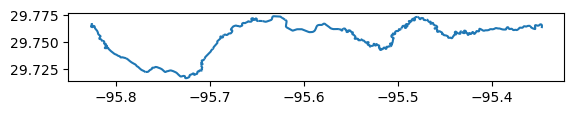

In [77]:
geodf_buffaloBayou.plot()

In [78]:
geodf_buffaloBayou[0:3]

,COMID,FDATE,RESOLUTION,GNIS_ID,GNIS_NAME,LENGTHKM,REACHCODE,FLOWDIR,WBAREACOMI,FTYPE,FCODE,SHAPE_LENG,ENABLED,GNIS_NBR,geometry
23242,1440301,1999-06-30,Medium,1372802,Buffalo Bayou,9.037,12040104000050,With Digitized,0,StreamRiver,46006,0.090057,True,0,"LINESTRING Z (-95.43197 29.75979 0.00000, -95...."
23243,1439353,1999-06-30,Medium,1372802,Buffalo Bayou,4.205,12040104000051,With Digitized,0,StreamRiver,46006,0.041334,True,0,"LINESTRING Z (-95.45952 29.76204 0.00000, -95...."
23244,1439313,1999-06-30,Medium,1372802,Buffalo Bayou,2.179,12040104000052,With Digitized,0,StreamRiver,46006,0.021320,True,0,"LINESTRING Z (-95.46905 29.77065 0.00000, -95...."


## Now we're get Brazos centerline

In [79]:
# Load the second shapefile and reproject it to EPSG:4326
gdf_nhda = gpd.read_file('../data/output_rem_data/v1/buffaloBayouRegionalV1_USGS10m_river_pts.shp') #python_data_processing/data/rivers_NHD/Shape/NHDWaterbody.shp
gdf_nhda = gdf_nhda.to_crs('EPSG:4326')

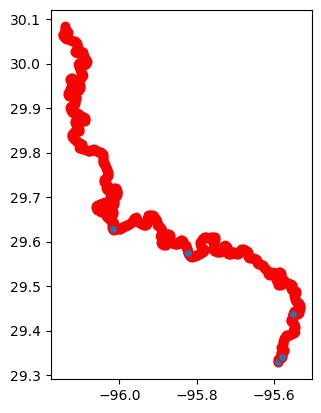

In [80]:
fig, ax = plt.subplots()
gdf_nhda.plot(ax=ax, edgecolor="red"); 

Those are points, not lines, so we'll have to turn them into line

/var/folders/ry/tr7t3nh122z_0n6rz2cl3lv40000gn/T/ipykernel_68335/2194634201.py:7: UserWarning: Geometry is in a geographic CRS. Results from 'distance' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  distances = gdf_nhda.geometry.distance(gdf_nhda.geometry.shift())


<AxesSubplot:>

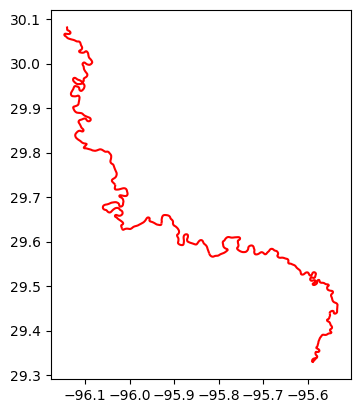

In [81]:
from shapely.geometry import LineString

# # Reproject the data to EPSG:4326
gdf_nhda = gdf_nhda.to_crs(epsg=4326)

# Calculate the distance between consecutive points
distances = gdf_nhda.geometry.distance(gdf_nhda.geometry.shift())

# Set a distance threshold
threshold = 0.04  # replace with your desired threshold

# Create a list to store the points for each LineString
points = []
lines = []

# Iterate over the points and distances
for point, distance in zip(gdf_nhda.geometry, distances):
    # If the distance is less than the threshold, add the point to the current LineString
    if distance <= threshold:
        points.append(point)
    # If the distance is greater than the threshold, start a new LineString
    else:
        # Only add LineStrings with more than one point
        if len(points) > 1:
            lines.append(LineString(points))
        points = [point]

# Add the last LineString if it has more than one point
if len(points) > 1:
    lines.append(LineString(points))

# Create a new GeoDataFrame with the LineStrings
gdf_nhda_lines = gpd.GeoDataFrame(geometry=lines)


# Plot the LineStrings
fig, ax = plt.subplots()
gdf_nhda_lines.plot(ax=ax, edgecolor="red")

In [82]:
# Combine the GeoDataFrames
geodf_buffaloBayou.to_crs(epsg=4326)
combined_gdf = gdf_nhda_lines.append(geodf_buffaloBayou)

# Reproject the data to EPSG:4326
combined_gdf = combined_gdf.set_crs(epsg=4326)

# Save the combined GeoDataFrame as a shapefile
combined_gdf.to_file("../data/reprojected_data/combined_BrazosBuffaloBayou.shp")

/var/folders/ry/tr7t3nh122z_0n6rz2cl3lv40000gn/T/ipykernel_68335/3178526709.py:3: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_gdf = gdf_nhda_lines.append(geodf_buffaloBayou)


Now let's confirm Brazos river and Buffalo bayou are in the same thing

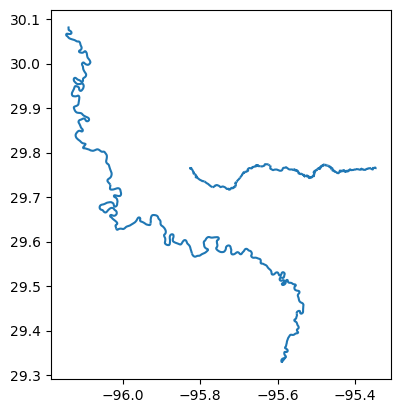

In [83]:
import geopandas as gpd

import matplotlib.pyplot as plt

# Load the shapefile
shapefile_path = "../data/reprojected_data/combined_BrazosBuffaloBayou.shp"
gdf = gpd.read_file(shapefile_path)

# Visualize the shapefile
gdf.plot()
plt.show()

## We also want to overlay faults

In [84]:
# Load the shapefile
gdf = gpd.read_file('../data/faults/texas_faults_fromDor/texas_faults.shp')

# Reproject the CRS to EPSG:4326
gdf_faults  = gdf.to_crs('EPSG:4269')

<AxesSubplot:>

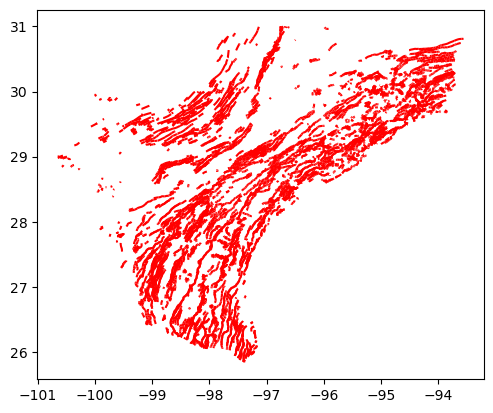

In [85]:
# Visualize the shapefiles
fig, ax = plt.subplots(1, 1)
gdf_faults.plot(ax=ax, color='red')

### Making a relative elevation model relative to the river center lines we have created

We use the RiverREM Python package
[https://github.com/OpenTopography/RiverREM](https://github.com/OpenTopography/RiverREM)

This tool is also highlighted on Open Topography at: [https://opentopography.org/blog/new-package-automates-river-relative-elevation-model-rem-generation](https://opentopography.org/blog/new-package-automates-river-relative-elevation-model-rem-generation)

In [90]:
from riverrem.REMMaker import REMMaker
# provide the DEM file path and desired output directory
rem_maker = REMMaker(dem='../data/input_rem_data/v2/viz.USGS10m_hillshade.tif', out_dir='../data/output_rem_data/v5/', centerline_shp='../data/reprojected_data/combined_BrazosBuffaloBayou.shp')
# create an REM
rem_maker.make_rem()
# create an REM visualization with the given colormap
rem_maker.make_rem_viz(cmap='mako_r')

[INFO] 2024-05-25 11:27:38,940 - Getting DEM projection.
[INFO] 2024-05-25 11:27:39,035 - Reading DEM as array.
[INFO] 2024-05-25 11:27:42,326 - Getting DEM bounds.
[INFO] 2024-05-25 11:27:42,354 - Mapping array indices to coordinates.
[INFO] 2024-05-25 11:27:42,410 - Using input centerline shapefile.
/Users/justingosses/opt/miniconda3/envs/river-dem/lib/python3.10/site-packages/riverrem/REMMaker.py:322: UserWarning: Geometry is in a geographic CRS. Results from 'length' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  self.river_length = self.rivers.length.sum()
[INFO] 2024-05-25 11:27:42,903 - Making river points shapefile.
[INFO] 2024-05-25 11:27:42,925 - Getting river elevation at DEM pixels.
[INFO] 2024-05-25 11:27:52,415 - Interpolating river elevation across DEM extent.
[INFO] 2024-05-25 11:27:52,420 - Estimating k.
[INFO] 2024-05-25 11:27:52,431 - Guessing k = 93
[INFO] 2024-05-25 11:27:52,432 - Using k = 93 ne


Making multidirectional hillshade raster.
Tiling and compressing raster.
Saved ./.cache/viz_hillshade.tif.

Making color relief map with cmap=mako_r.
Tiling and compressing raster.
Saved ./.cache/viz_REM_color-relief.tif.

Generating .png file.
Saved ./.cache/viz_REM_color-relief.png.

Making hillshade-color composite raster.
Tiling and compressing raster.
Saved ../data/output_rem_data/v5/viz_hillshade-color.tif.

Generating .png file.
Saved ../data/output_rem_data/v5/viz_hillshade-color.png.


'../data/output_rem_data/v5/viz_hillshade-color.tif'

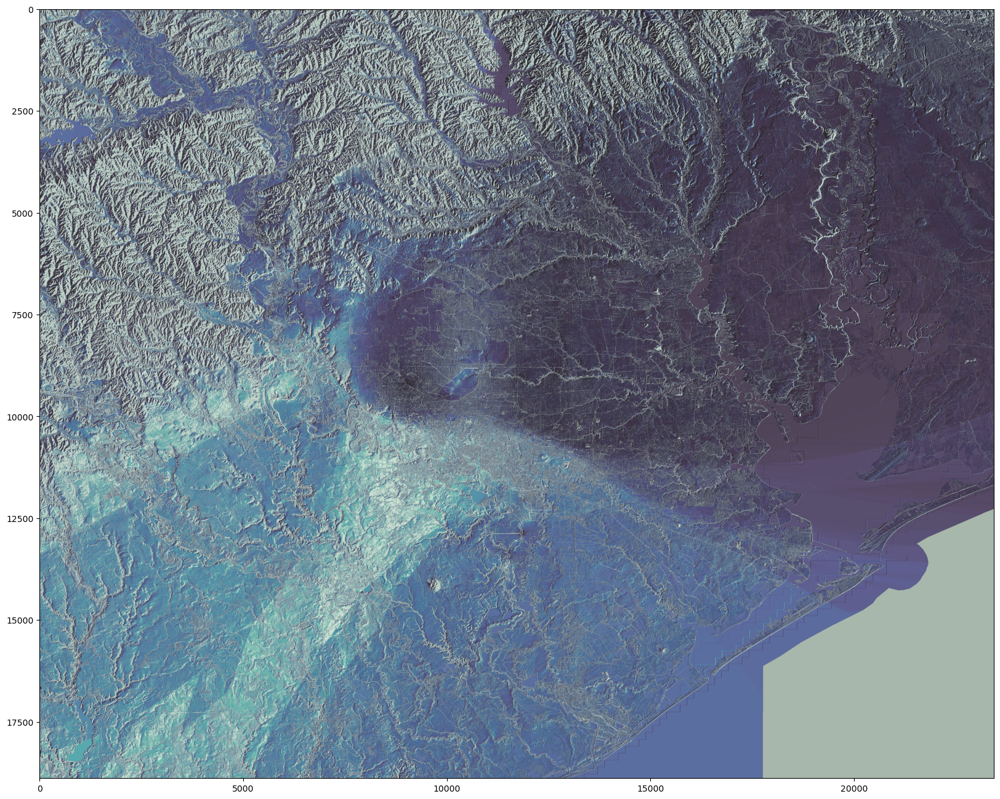

In [93]:
# Set the maximum image size limit
Image.MAX_IMAGE_PIXELS = None

# Load the PNG
img = Image.open('../data/output_rem_data/v5/viz_hillshade-color.png')
img_array = np.array(img)

# Plot the PNG
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
ax.imshow(img_array)

plt.show()

[INFO] 2024-05-25 12:09:02,509 - Failed to auto identify EPSG: 7


got to start of highway part
got different points on bounding box
pounts on building box =  30.599070763150337 28.850367107122846 -94.47500536682122 -96.64454234470855 north, south, east, west 
found points on bounding box
 got G from open street map
turned graph into geodataframe


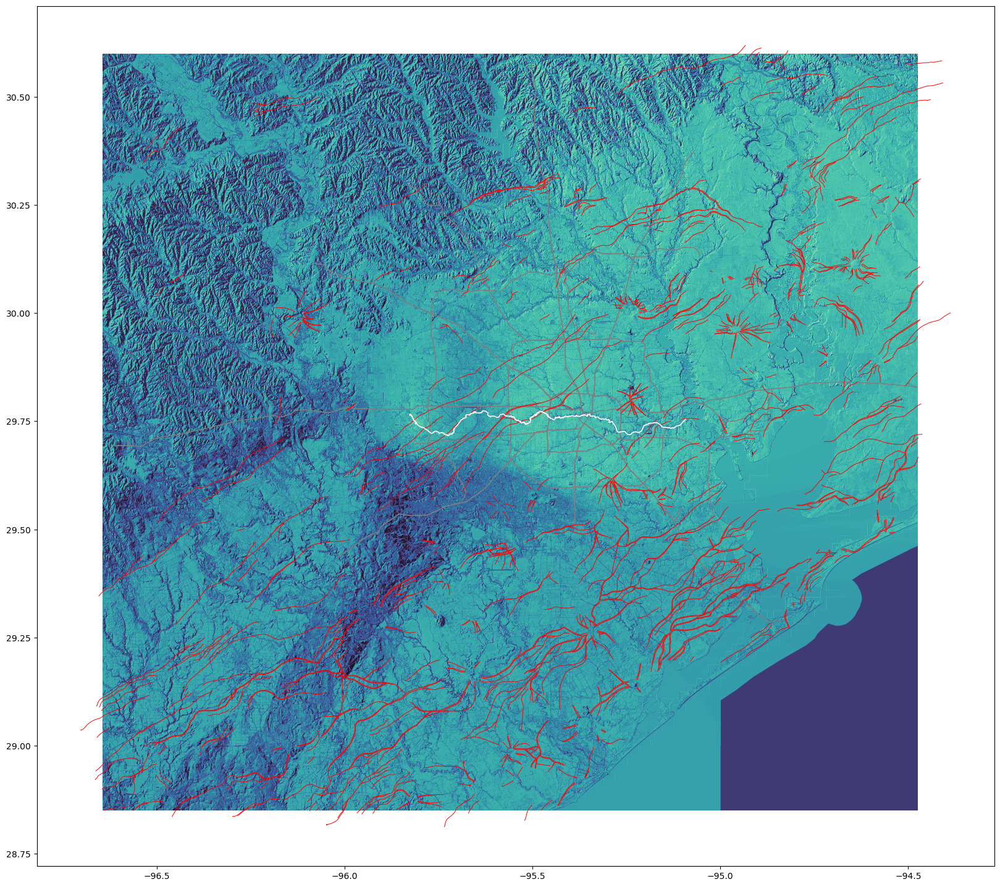

In [94]:
# Load the shapefile and reproject it to EPSG:4326
gdf_faults = gpd.read_file('../data/faults/texas_faults_fromDor/texas_faults.shp')
gdf_faults = gdf_faults.to_crs('EPSG:4326')

# Load the second shapefile and reproject it to EPSG:4326

shapefile = gpd.read_file('../data/rivers_NHD/Shape/NHDFlowline.shp')
shapefile[shapefile['gnis_name']!='Buffalo Bayou 3452']
geodf_buffaloBayou = shapefile[shapefile['gnis_name']=='Buffalo Bayou']
geodf_buffaloBayou.to_crs('EPSG:4326')

# Load the TIFF
with rasterio.open('../data/output_rem_data/v5/viz_hillshade-color.tif') as src:
    # Calculate the transform and the dimensions for the new CRS
    transform, width, height = calculate_default_transform(src.crs, 'EPSG:4326', src.width, src.height, *src.bounds)

    # Create a new raster for the reprojected TIFF
    with rasterio.open('reprojected.tif', 'w', driver='GTiff', height=height, width=width, count=1, dtype=src.dtypes[0], crs='EPSG:4326', transform=transform) as reprojected:
        # Reproject the TIFF to EPSG:4326
        reproject(
            source=rasterio.band(src, 1),
            destination=rasterio.band(reprojected, 1),
            src_transform=src.transform,
            src_crs=src.crs,
            dst_transform=transform,
            dst_crs='EPSG:4326',
            resampling=Resampling.nearest)

# Load the reprojected TIFF
with rasterio.open('reprojected.tif') as reprojected:
    img = reprojected.read(1)

    # Clip the reprojected shapefile to the extent of the reprojected TIFF
    gdf_faults = gdf_faults.cx[reprojected.bounds.left:reprojected.bounds.right, reprojected.bounds.bottom:reprojected.bounds.top]
    geodf_buffaloBayou = geodf_buffaloBayou.cx[reprojected.bounds.left:reprojected.bounds.right, reprojected.bounds.bottom:reprojected.bounds.top]


print("got to start of highway part")

# Get the bounds from the reprojected GeoDataFrame
bounds = reprojected.bounds

# Create a bounding box from the bounds
bbox = gpd.GeoDataFrame({'geometry': [box(*bounds)]}, crs=reprojected.crs)
# Reproject the bounding box to WGS84 (the CRS used by OpenStreetMap)
bbox = bbox.to_crs(epsg=4326)

print("got different points on bounding box")

# Get the bounding box coordinates
west, south, east, north = bbox.total_bounds
#-96.20731933611141 29.324996273771987 -94.63444939569881 30.083329399808324 north, south, east, west 

print("pounts on building box = ",north, south, east, west , "north, south, east, west ")
print("found points on bounding box")

# Define the filter
custom_filter = '["highway"~"motorway"]'

# Download the road network
G = ox.graph_from_bbox(north, south, east, west, network_type='drive', custom_filter=custom_filter)

print(" got G from open street map")

# Convert the road network to a GeoDataFrame
edges = ox.graph_to_gdfs(G, nodes=False, edges=True)

print("turned graph into geodataframe")

# Plot the reprojected TIFF
fig, ax = plt.subplots(1, 1, figsize=(20, 20))  # Adjust the size as needed
show(img, ax=ax, transform=transform, cmap='mako_r')


# Overlay the road network
edges.plot(ax=ax, color='gray', linewidth=0.8)  # Adjust color and linewidth as needed

# Overlay the reprojected and clipped shapefile
gdf_faults.plot(ax=ax, color='red', edgecolor='red', linewidth=0.7)
geodf_buffaloBayou.plot(ax=ax, color='white', edgecolor='white', linewidth=1.25)

# Save the plot to a PNG file
plt.savefig('../data/output_rem_data/v4/tiffPlusOverlaysPlot_vA.png', dpi=500) 

plt.show()

#### There are some artifacts it looks like in the SW portion of the image, so ,let's try doing the REM creation without giving any shape file river extents. In this case, the REM code will do a search for the longest river I believe.

In [95]:
from riverrem.REMMaker import REMMaker
# provide the DEM file path and desired output directory
rem_maker = REMMaker(dem='../data/input_rem_data/v2/viz.USGS10m_hillshade.tif', out_dir='../data/output_rem_data/v5b/')
# create an REM
rem_maker.make_rem()
# create an REM visualization with the given colormap
rem_maker.make_rem_viz(cmap='mako_r')

[INFO] 2024-05-26 16:59:06,386 - Getting DEM projection.
[INFO] 2024-05-26 16:59:06,479 - Reading DEM as array.
[INFO] 2024-05-26 16:59:08,290 - Getting DEM bounds.
[INFO] 2024-05-26 16:59:08,315 - Mapping array indices to coordinates.
[INFO] 2024-05-26 16:59:08,592 - Finding river centerline.
[INFO] 2024-05-26 16:59:59,506 - Found river(s): Coon Creek, Mustang Creek, Tarkington Bayou, Sandy Creek, Willow Waterhole Bayou, G103-38-00, Middle Sandy Creek, Brays Bayou, American Canal, Hog Branch, Keegans Bayou, Chigger Creek, Cedar Bayou, Lewis Creek, Atkins Creek, Rummel Creek, Varner Creek, Cummins Creek, Bastrop Bayou, West Fork San Jacinto River, Berry Bayou, Bookshire Creek, Ward Gully, Harpers Horsepen Branch, Brickhouse Gully, Davidson Creek, Navidad River, Yupon Creek, Alligator Alley, Rolling Fork, Moses Bayou, Little White Oak Bayou, Willowspring Creek, Sheppard Creek, West Bernard Creek, Pole Creek, Alcorn Bayou, Cannon Creek, West Fork Double Bayou, Sand Branch, Lemm Gully, Co


Making multidirectional hillshade raster.
Tiling and compressing raster.
Saved ./.cache/viz_hillshade.tif.

Making color relief map with cmap=mako_r.
Tiling and compressing raster.
Saved ./.cache/viz_REM_color-relief.tif.

Generating .png file.
Saved ./.cache/viz_REM_color-relief.png.

Making hillshade-color composite raster.
Tiling and compressing raster.
Saved ../data/output_rem_data/v5b/viz_hillshade-color.tif.

Generating .png file.
Saved ../data/output_rem_data/v5b/viz_hillshade-color.png.


'../data/output_rem_data/v5b/viz_hillshade-color.tif'

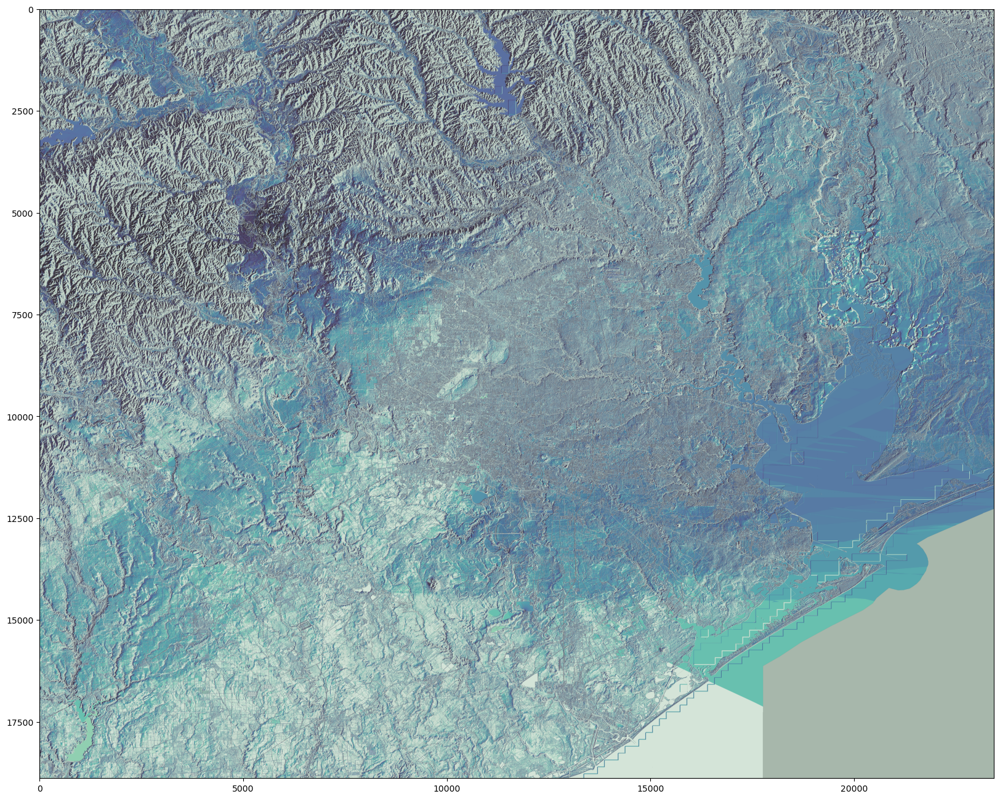

In [96]:
# Set the maximum image size limit
Image.MAX_IMAGE_PIXELS = None

# Load the PNG
img = Image.open('../data/output_rem_data/v5b/viz_hillshade-color.png')
img_array = np.array(img)

# Plot the PNG
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
ax.imshow(img_array)

plt.show()

[INFO] 2024-05-26 21:54:10,862 - Failed to auto identify EPSG: 7


got to start of highway part
got different points on bounding box
pounts on building box =  30.599070763150337 28.850367107122846 -94.47500536682122 -96.64454234470855 north, south, east, west 
found points on bounding box
 got G from open street map
turned graph into geodataframe


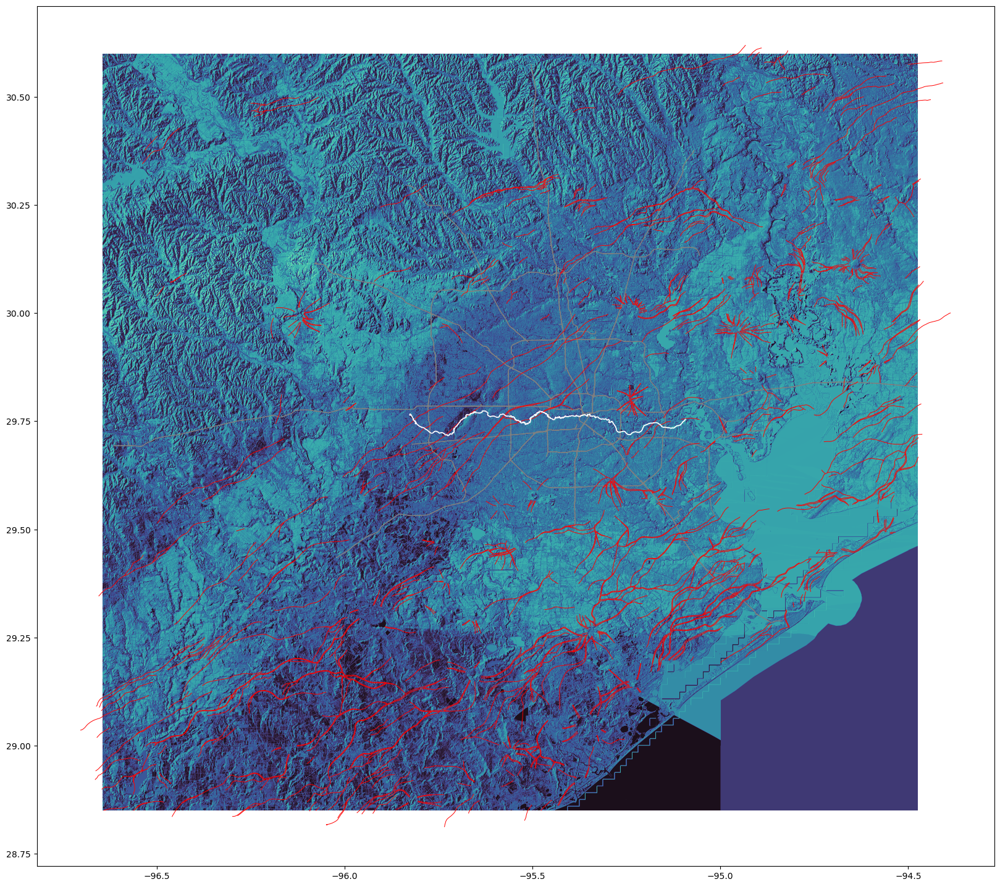

In [97]:
# Load the shapefile and reproject it to EPSG:4326
gdf_faults = gpd.read_file('../data/faults/texas_faults_fromDor/texas_faults.shp')
gdf_faults = gdf_faults.to_crs('EPSG:4326')

# Load the second shapefile and reproject it to EPSG:4326

shapefile = gpd.read_file('../data/rivers_NHD/Shape/NHDFlowline.shp')
shapefile[shapefile['gnis_name']!='Buffalo Bayou 3452']
geodf_buffaloBayou = shapefile[shapefile['gnis_name']=='Buffalo Bayou']
geodf_buffaloBayou.to_crs('EPSG:4326')

# Load the TIFF
with rasterio.open('../data/output_rem_data/v5b/viz_hillshade-color.tif') as src:
    # Calculate the transform and the dimensions for the new CRS
    transform, width, height = calculate_default_transform(src.crs, 'EPSG:4326', src.width, src.height, *src.bounds)

    # Create a new raster for the reprojected TIFF
    with rasterio.open('reprojected.tif', 'w', driver='GTiff', height=height, width=width, count=1, dtype=src.dtypes[0], crs='EPSG:4326', transform=transform) as reprojected:
        # Reproject the TIFF to EPSG:4326
        reproject(
            source=rasterio.band(src, 1),
            destination=rasterio.band(reprojected, 1),
            src_transform=src.transform,
            src_crs=src.crs,
            dst_transform=transform,
            dst_crs='EPSG:4326',
            resampling=Resampling.nearest)

# Load the reprojected TIFF
with rasterio.open('reprojected.tif') as reprojected:
    img = reprojected.read(1)

    # Clip the reprojected shapefile to the extent of the reprojected TIFF
    gdf_faults = gdf_faults.cx[reprojected.bounds.left:reprojected.bounds.right, reprojected.bounds.bottom:reprojected.bounds.top]
    geodf_buffaloBayou = geodf_buffaloBayou.cx[reprojected.bounds.left:reprojected.bounds.right, reprojected.bounds.bottom:reprojected.bounds.top]


print("got to start of highway part")

# Get the bounds from the reprojected GeoDataFrame
bounds = reprojected.bounds

# Create a bounding box from the bounds
bbox = gpd.GeoDataFrame({'geometry': [box(*bounds)]}, crs=reprojected.crs)
# Reproject the bounding box to WGS84 (the CRS used by OpenStreetMap)
bbox = bbox.to_crs(epsg=4326)

print("got different points on bounding box")

# Get the bounding box coordinates
west, south, east, north = bbox.total_bounds
#-96.20731933611141 29.324996273771987 -94.63444939569881 30.083329399808324 north, south, east, west 

print("pounts on building box = ",north, south, east, west , "north, south, east, west ")
print("found points on bounding box")

# Define the filter
custom_filter = '["highway"~"motorway"]'

# Download the road network
G = ox.graph_from_bbox(north, south, east, west, network_type='drive', custom_filter=custom_filter)

print(" got G from open street map")

# Convert the road network to a GeoDataFrame
edges = ox.graph_to_gdfs(G, nodes=False, edges=True)

print("turned graph into geodataframe")

# Plot the reprojected TIFF
fig, ax = plt.subplots(1, 1, figsize=(20, 20))  # Adjust the size as needed
show(img, ax=ax, transform=transform, cmap='mako_r')


# Overlay the road network
edges.plot(ax=ax, color='gray', linewidth=0.8)  # Adjust color and linewidth as needed

# Overlay the reprojected and clipped shapefile
gdf_faults.plot(ax=ax, color='red', edgecolor='red', linewidth=0.7)
geodf_buffaloBayou.plot(ax=ax, color='white', edgecolor='white', linewidth=1.25)

# Save the plot to a PNG file
plt.savefig('../data/output_rem_data/v4/tiffPlusOverlaysPlot_vA.png', dpi=500) 

plt.show()

## Switching approach and trying to use whitebox geospatial's relative topographic position function

In [42]:
path_to_input_dem_tiff = '../data/input_rem_data/v2/viz.USGS10m_hillshade.tif'

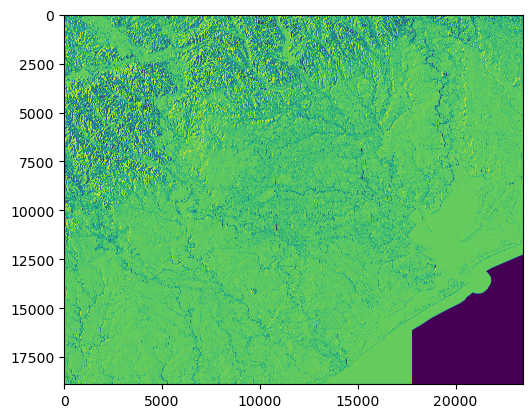

In [43]:
# Load the TIFF
with rasterio.open(path_to_input_dem_tiff ) as src:
    img = src.read(1)  # read the first band
    
# Plot the TIFF
fig, ax = plt.subplots(1, 1)
show(img, ax=ax)
plt.show()

In [99]:
#!conda install -c conda-forge whitebox_tools 

In [120]:
#!pip install whitebox

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.3/72.3 kB 353.7 kB/s eta 0:00:0000:010:01


In [5]:
import whitebox
whitebox.download_wbt(linux_musl=True, reset=True)


Decompressing WhiteboxTools_darwin_m_series.zip ...
WhiteboxTools package directory: /Users/justingosses/opt/miniconda3/envs/river-dem/lib/python3.10/site-packages/whitebox


In [6]:
dir(whitebox)

['Runner',
 'WhiteboxTools',
 '__author__',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__email__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 '__version__',
 'download_wbt',
 'whitebox',
 'whitebox_tools']

In [7]:
wbt = whitebox.WhiteboxTools()
print(wbt.version())
print(wbt.help())

WhiteboxTools v2.4.0 (c) Dr. John Lindsay 2017-2023

WhiteboxTools is an advanced geospatial data analysis platform developed at
the University of Guelph's Geomorphometry and Hydrogeomatics Research 
Group (GHRG). See www.whiteboxgeo.com for more details.

WhiteboxTools Help

The following commands are recognized:
--cd, --wd          Changes the working directory; used in conjunction with --run flag.
--compress_rasters  Sets the compress_raster option in the settings.json file; determines if newly created rasters are compressed. e.g. --compress_rasters=true
-h, --help          Prints help information.
-l, --license       Prints the whitebox-tools license. Tool names may also be used, --license="Slope"
--listtools         Lists all available tools. Keywords may also be used, --listtools slope.
--max_procs         Sets the maximum number of processors used. -1 = all available processors. e.g. --max_procs=2
-r, --run           Runs a tool; used in conjunction with --wd flag; -r="LidarInfo

https://whiteboxgeo.com/manual/wbt_book/available_tools/geomorphometric_analysis.html#RelativeTopographicPosition

In [8]:
output_tiff_path = '../data/output_rem_data/v5/whiteboxREM_vA.tif'

In [9]:
import os
import pkg_resources

In [10]:
# identify the sample data directory of the package
data_dir = os.path.dirname(pkg_resources.resource_filename("whitebox", 'testdata/'))


In [11]:
data_dir

'/Users/justingosses/opt/miniconda3/envs/river-dem/lib/python3.10/site-packages/whitebox/testdata'

In [12]:
wbt.set_working_dir(data_dir)

In [13]:
def default_callback(value):
    return value 

In [14]:
path_to_input_dem_tiff = '../data/input_rem_data/v2/viz.USGS10m_hillshade.tif'

In [44]:

output_A = wbt.relative_topographic_position(
    dem=img, 
    output=output_tiff_path, 
    filterx=11, 
    filtery=11,
    #callback=default_callback
)


That went for 44 minutes and didn't finish, so let's try a smaller tiff

In [16]:
print("test")

test


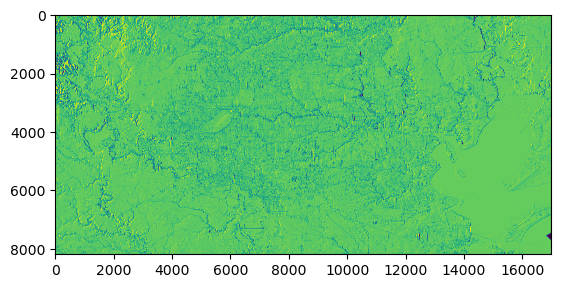

In [15]:
# Load the TIFF
with rasterio.open('../data/input_rem_data/viz.USGS10m_hillshade.tif') as src:
    imgSmall = src.read(1)  # read the first band
    
# Plot the TIFF
fig, ax = plt.subplots(1, 1)
show(imgSmall , ax=ax)
plt.show()

In [39]:
output_tiff_path_small = '../data/output_rem_data/v6/whiteboxREM_vAsmall.tif'
output_tiff_path_small2 = '../data/output_rem_data/v6/output_rem.tif'

In [29]:
import os

os.environ['RUST_BACKTRACE'] = 'full'

In [40]:

output_A = wbt.relative_topographic_position(
    dem='../data/input_rem_data/viz.USGS10m_hillshade.tif', 
    output=output_tiff_path_small2 , 
    filterx=11, 
    filtery=11
    #callback=default_callback
)

./whitebox_tools --run="RelativeTopographicPosition" --wd="/Users/justingosses/opt/miniconda3/envs/river-dem/lib/python3.10/site-packages/whitebox/testdata" --dem='../data/input_rem_data/viz.USGS10m_hillshade.tif' --output='../data/output_rem_data/v6/output_rem.tif' --filterx=11 --filtery=11 -v --compress_rasters=False

******************************************
* Welcome to RelativeTopographicPosition *
* Powered by WhiteboxTools               *
* www.whiteboxgeo.com                    *
******************************************
Reading data...
thread 'main' panicked at whitebox-tools-app/src/main.rs:72:21:
No such file or directory (os error 2)
stack backtrace:
0:        0x102c518d0 - __mh_execute_header
1:        0x102c71ad8 - __mh_execute_header
2:        0x102c4eb38 - __mh_execute_header
3:        0x102c51728 - __mh_execute_header
4:        0x102c52c3c - __mh_execute_header
5:        0x102c52920 - __mh_execute_header
6:        0x102c53530 - __mh_execute_header
7:        0x102c52f

In [38]:
output_A

0

## Whitebox tools doesn't seem to work , at least this function so moving on to other options

In [41]:
import scipy

In [43]:
src = rasterio.open('../data/input_rem_data/viz.USGS10m_hillshade.tif')
r = src.read()


In [44]:
print(np.min(r))
print(np.max(r))

0
237


In [45]:
r.shape

(1, 8190, 16987)

In [46]:
np.min(r, axis=(1, 2))

array([0], dtype=uint8)

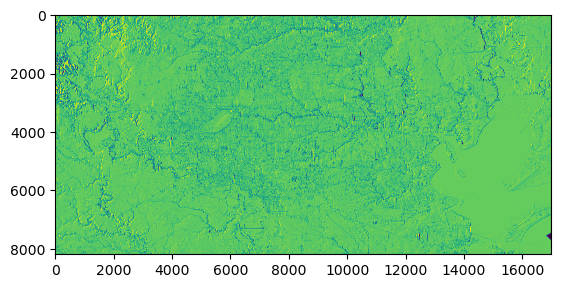

<AxesSubplot:>

In [47]:
rasterio.plot.show(r)


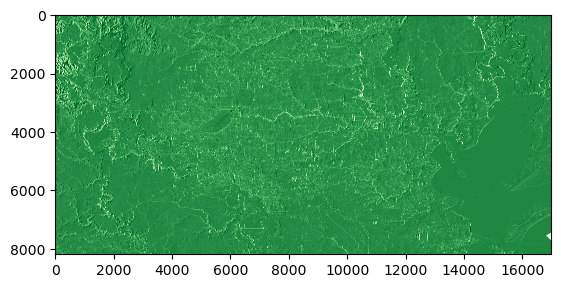

In [48]:
rasterio.plot.show(r, cmap="Greens");

In [50]:
r_filter51 = scipy.ndimage.uniform_filter(r, 51)

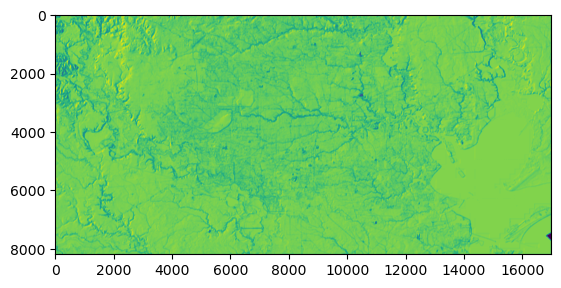

<AxesSubplot:>

In [51]:
rasterio.plot.show(r_filter51)


In [52]:
r_filter500 = scipy.ndimage.uniform_filter(r, 500)

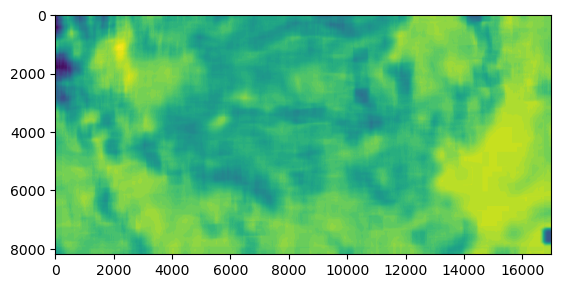

<AxesSubplot:>

In [53]:
rasterio.plot.show(r_filter500)

### Wait, I'm looking at hillshade, not DEM, let's try again

In [56]:
srcd = rasterio.open('../data/input_rem_data/v2/output_USGS10m.tif')
#src.read([1, 2, 3], masked=True)
d = srcd.read([1],masked=True)

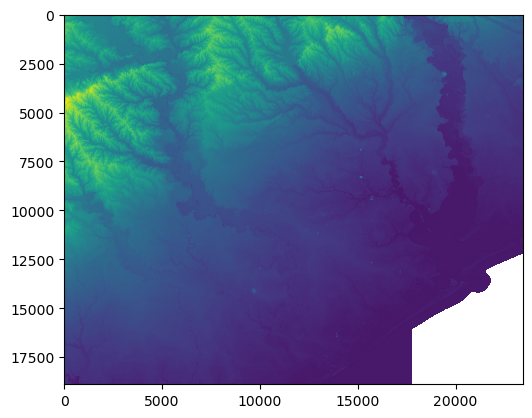

<AxesSubplot:>

In [57]:
rasterio.plot.show(d)

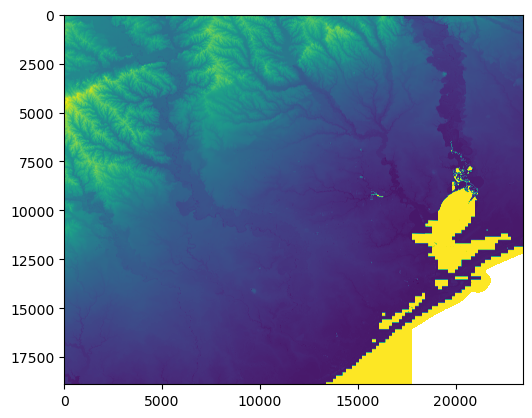

<AxesSubplot:>

In [65]:
d[d==0] = np.max(d)
show(d)

In [66]:
d_filter500 = scipy.ndimage.uniform_filter(d, 500)

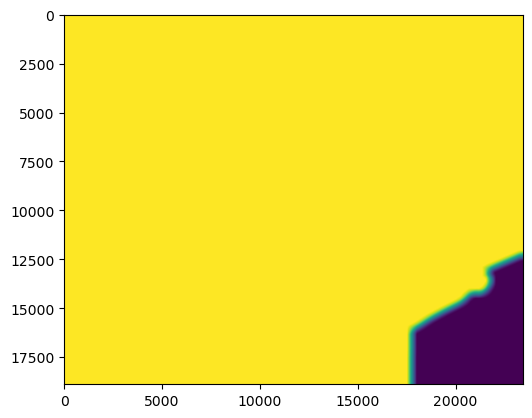

<AxesSubplot:>

In [63]:
rasterio.plot.show(d_filter500)

In [5]:
# Read the raster file 
with rasterio.open('../data/input_rem_data/v2/output_USGS10m.tif') as src:
    raster_data = src.read(1)
    nodata_value = src.nodata 
    print("Nodata value:", nodata_value)

Nodata value: -999999.0


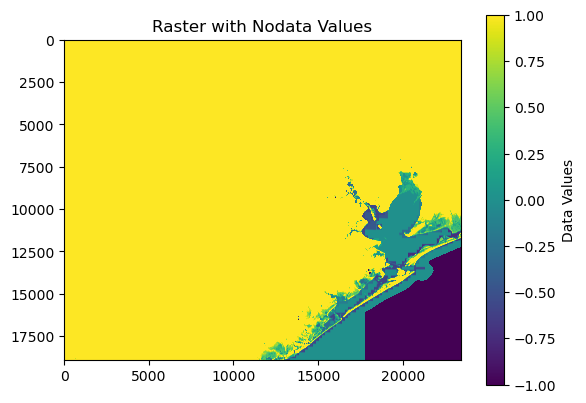

In [6]:
#import matplotlib.pyplot as plt 
plt.imshow(raster_data, cmap='viridis', vmin=-1, vmax=1) 
plt.colorbar(label='Data Values') 
plt.title('Raster with Nodata Values') 
plt.show()

Because all the no data is is basically sea levle, we can replace it with zeros

In [7]:
# Replace nodata values with a new value (e.g., 0) 
new_raster_data = np.where(raster_data == nodata_value, 0, raster_data)

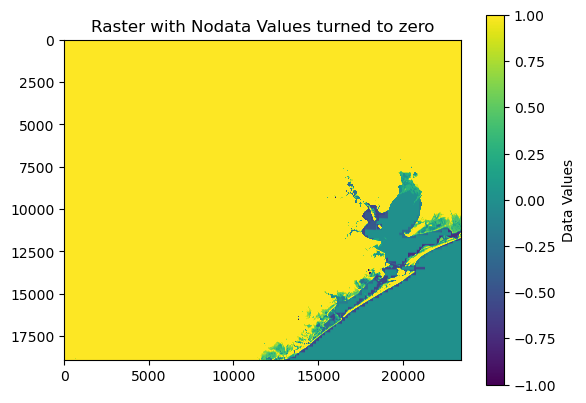

In [9]:
plt.imshow(new_raster_data , cmap='viridis', vmin=-1, vmax=1) 
plt.colorbar(label='Data Values') 
plt.title('Raster with Nodata Values turned to zero') 
plt.show()

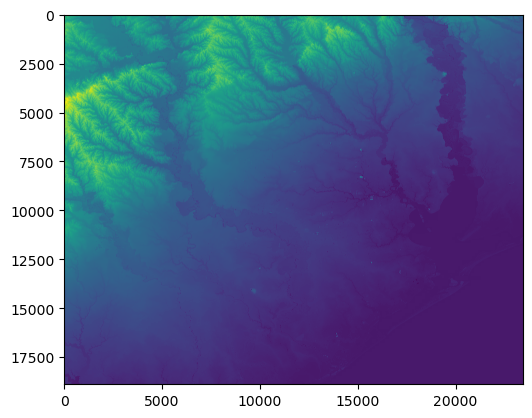

<AxesSubplot:>

In [10]:
rasterio.plot.show(new_raster_data)

In [19]:
# Write the output raster with the updated nodata value
# we have to do this as REMriver program reads a tiff from a file only
output_raster = "../data/input_rem_data/v2/output_USGS10m_NoDataChangedToZero.tif"
#profile = new_raster_data.profile
with rasterio.open('../data/input_rem_data/v2/output_USGS10m.tif') as src:
    profile = src.profile
    # Set the new nodata value in the profile
    profile.update(nodata=0)
    with rasterio.open(output_raster, "w",**profile) as dst:
        dst.write(new_raster_data)

ValueError: Source shape (18886, 23431) is inconsistent with given indexes 1

In [20]:
# Add an extra dimension to new_raster_data
new_raster_data = new_raster_data[np.newaxis, :, :]

# Write the output raster with the updated nodata value
output_raster = "../data/input_rem_data/v2/output_USGS10m_NoDataChangedToZero.tif"
with rasterio.open('../data/input_rem_data/v2/output_USGS10m.tif') as src:
    profile = src.profile
    # Set the new nodata value in the profile
    profile.update(nodata=0)
    with rasterio.open(output_raster, "w", **profile) as dst:
        dst.write(new_raster_data)

#### Now how do I take averaged surface - actual DEM surface and find REM surface?

In [21]:
# # write the result to a new raster
# relative_to_500avg_dem = relative_d = d_filter500 - d
# with rasterio.open("../data/output_rem_data/v6/relativeManualw500avg.tif", 'w') as dst:
#         dst.write(datarelative_to_500avg_dem,1)


In [22]:
#---------

In [23]:
from riverrem.REMMaker import REMMaker
# provide the DEM file path and desired output directory
rem_maker = REMMaker(dem='../data/input_rem_data/v2/output_USGS10m_NoDataChangedToZero.tif', out_dir='../data/output_rem_data/v6/', centerline_shp='../data/reprojected_data/combined_BrazosBuffaloBayou.shp')
# create an REM
rem_maker.make_rem()
# create an REM visualization with the given colormap
rem_maker.make_rem_viz(cmap='mako_r')

[INFO] 2024-06-01 16:42:52,774 - Getting DEM projection.
[INFO] 2024-06-01 16:42:52,790 - Reading DEM as array.
[INFO] 2024-06-01 16:42:52,790 - Reading DEM as array.


## The no data values in the regional DEM tiff is not playing well with REM and other things so need to get them out